# Simulaciones con incertidumbre - Biblioteca EVQueues.jl

In [1]:
using EVQueues, Plots, ProgressMeter

In [2]:
lambda=80.0;
mu=1.0;
gamma=0.5;
C=60.0;

Tfinal=50.0;
snaps = collect(0.1:0.1:Tfinal);

In [3]:
df = generate_Poisson_stream(lambda,mu,gamma,Tfinal);

In [4]:
sim0 = ev_edf_trace(df,C,snapshots=snaps);
compute_statistics!(sim0)

Simulando... 100%|██████████████████████████████████████| Time: 0:00:00


In [5]:
##Trabajo no cumplido
sim0.stats.avgW

0.2153318970503562

Creando animacion... 100%|██████████████████████████████| Time: 0:00:14
┌ Info: Saved animation to 
│   fn = /tmp/anim.gif
└ @ Plots /home/andres/.julia/packages/Plots/vsE7b/src/animation.jl:104


Plots.AnimatedGif("/tmp/anim.gif")
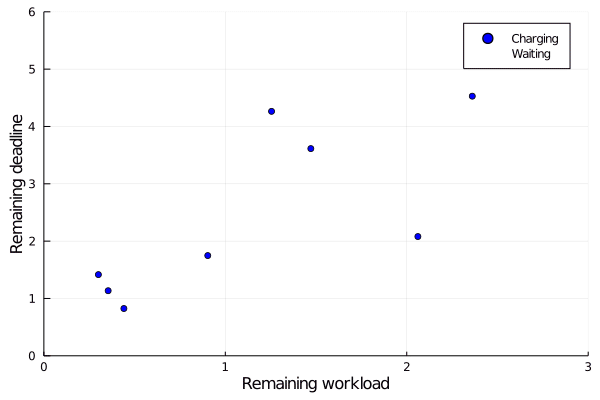

In [7]:
prog=Progress(length(snaps), dt=1, desc="Creando animacion... ");

anim = @animate for snapshot in sim0.snapshots

    stateplot(snapshot.charging, xlims=(0,3/mu), ylims=(0,3/gamma))

    next!(prog);
end

gif(anim, "/tmp/anim.gif", fps = 10)

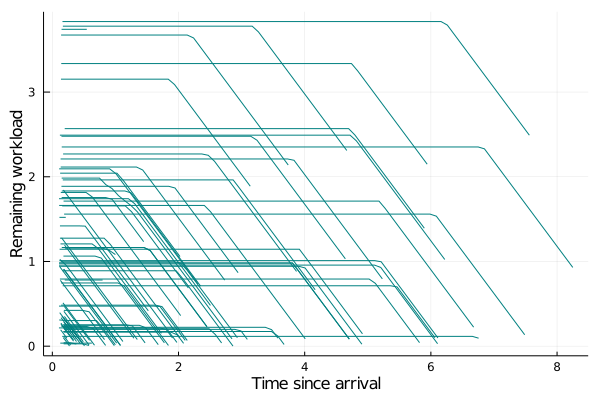

In [9]:
#diccionario para guardar los autos
d = get_vehicle_trajectories(sim0)

p=plot(legend=:none);

using StatsBase

#I choose n cars to display
n=100
trajectories = collect(values(d))
K = sample((1:length(trajectories)),n)

for k=K

    trace = trajectories[k];

    t = [z[1] for z in trace]
    sigma = [z[2] for z in trace]
    tau = [z[3] for z in trace]

    plot!(p,t,sigma, color=:teal, xlabel="Time since arrival", ylabel="Remaining workload")
end
p

In [11]:
using Distributions

sigma=1.0

perturbation = Normal(0,sigma)

reportedDeadlines = [d+rand(perturbation) for d in df[!,:salidas]]
df[!,:salidaReportada] = reportedDeadlines

sim1 = ev_edf_trace(df,C,snapshots=snaps);
compute_statistics!(sim1)

In [12]:
sim1.stats.avgW

0.2185476853713411

Creando animacion... 100%|██████████████████████████████| Time: 0:00:15
┌ Info: Saved animation to 
│   fn = /tmp/anim.gif
└ @ Plots /home/andres/.julia/packages/Plots/vsE7b/src/animation.jl:104


Plots.AnimatedGif("/tmp/anim.gif")
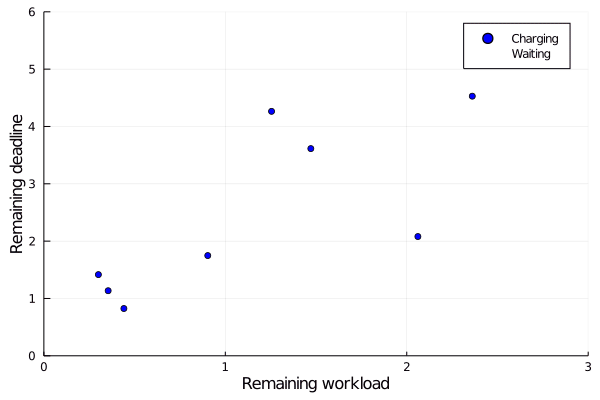

In [13]:
prog=Progress(length(snaps), dt=1, desc="Creando animacion... ");

anim = @animate for snapshot in sim1.snapshots

    stateplot(snapshot.charging, xlims=(0,3/mu), ylims=(0,3/gamma))

    next!(prog);
end

gif(anim, "/tmp/anim.gif", fps = 10)

Creando animacion... 100%|██████████████████████████████| Time: 0:00:14
┌ Info: Saved animation to 
│   fn = /tmp/anim.gif
└ @ Plots /home/andres/.julia/packages/Plots/vsE7b/src/animation.jl:104


Plots.AnimatedGif("/tmp/anim.gif")
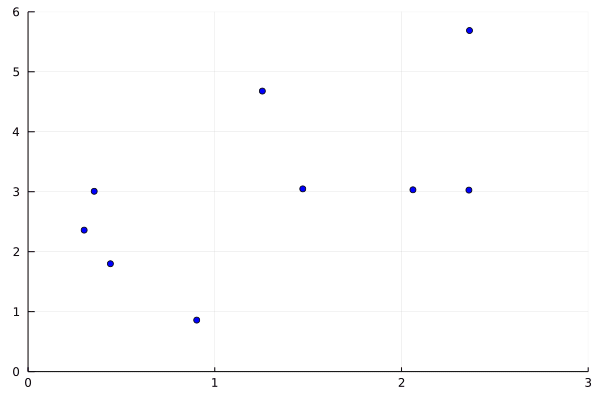

In [14]:
prog=Progress(length(snaps), dt=1, desc="Creando animacion... ");

anim = @animate for snapshot in sim1.snapshots

    charging = [ev for ev in snapshot.charging]
    w = [ev.currentWorkload for ev in charging]
    d = [ev.currentReportedDeadline for ev in charging]
    u = [ev.currentPower for ev in charging]

    p=scatter(w[u.>0],d[u.>0],markershape=:circle,color=:blue,legend=:none,xlims = (0,3/mu), ylims = (0,3/gamma));
    scatter!(p,w[u.==0],d[u.==0],markershape=:circle,color=:red,legend=:none);

    next!(prog);
end

gif(anim, "/tmp/anim.gif", fps = 10)

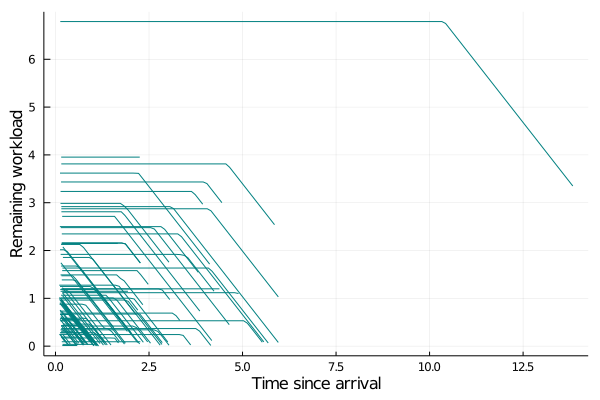

In [15]:
#diccionario para guardar los autos
d = get_vehicle_trajectories(sim1)

p=plot(legend=:none);

using StatsBase

#I choose n cars to display
n=100
trajectories = collect(values(d))
K = sample((1:length(trajectories)),n)

for k=K

    trace = trajectories[k];

    t = [z[1] for z in trace]
    sigma = [z[2] for z in trace]
    tau = [z[3] for z in trace]

    plot!(p,t,sigma, color=:teal, xlabel="Time since arrival", ylabel="Remaining workload")
end
p

In [16]:
sim2 = ev_lifo_trace(df,C,snapshots=snaps);
compute_statistics!(sim2)

In [17]:
sim2.stats.avgW

0.23821821548910227

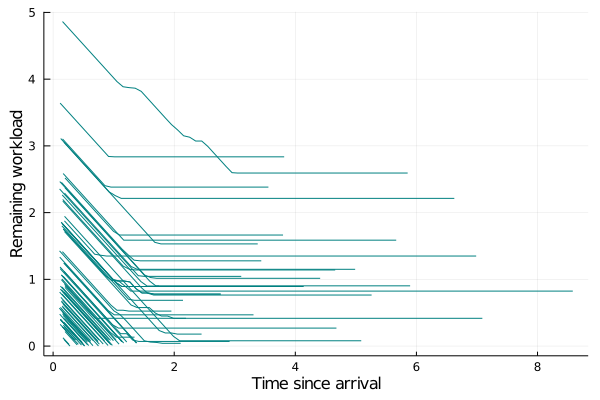

In [19]:
#diccionario para guardar los autos
d = get_vehicle_trajectories(sim2)

p=plot(legend=:none);

using StatsBase

#I choose n cars to display
n=100
trajectories = collect(values(d))
K = sample((1:length(trajectories)),n)

for k=K

    trace = trajectories[k];

    t = [z[1] for z in trace]
    sigma = [z[2] for z in trace]
    tau = [z[3] for z in trace]

    plot!(p,t,sigma, color=:teal, xlabel="Time since arrival", ylabel="Remaining workload")
end
p

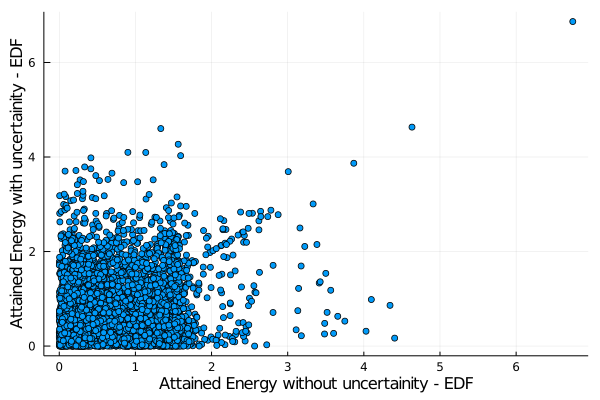

In [28]:
Sa0 = [ev.requestedEnergy - ev.departureWorkload for ev in sim0.EVs]
Sa1 = [ev.requestedEnergy - ev.departureWorkload for ev in sim1.EVs]
Sa2 = [ev.requestedEnergy - ev.departureWorkload for ev in sim2.EVs]

scatter(Sa0,Sa1,legend=:none, xlabel="Attained Energy without uncertainity - $(sim0.parameters["Policy"])", ylabel="Attained Energy with uncertainity - $(sim1.parameters["Policy"])")

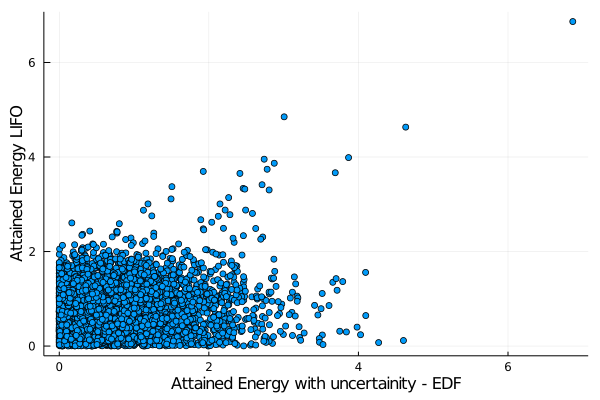

In [30]:
scatter(Sa1,Sa2,legend=:none, xlabel="Attained Energy with uncertainity - $(sim1.parameters["Policy"])", ylabel="Attained Energy $(sim2.parameters["Policy"])")